In [72]:
import numpy as np
import pandas as pd
import nltk
import matplotlib.pyplot as plt
import kagglehub
import string
from wordcloud import WordCloud, STOPWORDS
from gensim.models import Word2Vec, FastText
from sklearn.decomposition import PCA
import plotly.graph_objects as go
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import accuracy_score, confusion_matrix , classification_report
import matplotlib.pyplot as plt
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.svm import SVC
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from nltk.corpus import stopwords
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import precision_recall_fscore_support
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer

## Logistic Regression

In [37]:
def swap_columns(df, col1, col2):
    col_list = list(df.columns)
    x, y = col_list.index(col1), col_list.index(col2)
    col_list[y], col_list[x] = col_list[x], col_list[y]
    df = df[col_list]
    return df

In [38]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [39]:
# data from https://www.kaggle.com/datasets/venky73/spam-mails-dataset
# path = kagglehub.dataset_download("venky73/spam-mails-dataset")
dataset = pd.read_csv('/content/drive/MyDrive/CS410/spam_ham_dataset.csv')

In [40]:
dataset.head()

,Unnamed: 0,label,text,label_num
0,605,ham,Subject: enron methanol ; meter # : 988291\r\n...,0
1,2349,ham,"Subject: hpl nom for january 9 , 2001\r\n( see...",0
2,3624,ham,"Subject: neon retreat\r\nho ho ho , we ' re ar...",0
3,4685,spam,"Subject: photoshop , windows , office . cheap ...",1
4,2030,ham,Subject: re : indian springs\r\nthis deal is t...,0


In [41]:
c = dataset['label'].value_counts()
c

,count
label,
ham,3672
spam,1499


In [42]:
dataset = dataset.drop('Unnamed: 0', axis=1)
dataset = dataset.drop('label', axis=1)
dataset.head()

,text,label_num
0,Subject: enron methanol ; meter # : 988291\r\n...,0
1,"Subject: hpl nom for january 9 , 2001\r\n( see...",0
2,"Subject: neon retreat\r\nho ho ho , we ' re ar...",0
3,"Subject: photoshop , windows , office . cheap ...",1
4,Subject: re : indian springs\r\nthis deal is t...,0


In [43]:
subjects = []
for i in range(len(dataset)):
    ln = dataset["text"][i]
    line = ""
    for i in ln:
        if(i == '\r'):
            break
        line = line + i
    line = line.replace("Subject" , "")
    subjects.append(line)

In [44]:
dataset['Subject'] = subjects
dataset.head()

,text,label_num,Subject
0,Subject: enron methanol ; meter # : 988291\r\n...,0,: enron methanol ; meter # : 988291
1,"Subject: hpl nom for january 9 , 2001\r\n( see...",0,": hpl nom for january 9 , 2001"
2,"Subject: neon retreat\r\nho ho ho , we ' re ar...",0,: neon retreat
3,"Subject: photoshop , windows , office . cheap ...",1,": photoshop , windows , office . cheap . main ..."
4,Subject: re : indian springs\r\nthis deal is t...,0,: re : indian springs


In [45]:
dataset.columns = ['Email_text', 'Labels', 'Email_Subject']
dataset.head()
dataset = swap_columns(dataset, 'Labels', 'Email_Subject')

In [46]:
dataset['Email_Subject'] = dataset['Email_Subject'].str.lower()
dataset['Email_text'] = dataset['Email_text'].str.lower()
dataset.head()

,Email_text,Email_Subject,Labels
0,subject: enron methanol ; meter # : 988291\r\n...,: enron methanol ; meter # : 988291,0
1,"subject: hpl nom for january 9 , 2001\r\n( see...",": hpl nom for january 9 , 2001",0
2,"subject: neon retreat\r\nho ho ho , we ' re ar...",: neon retreat,0
3,"subject: photoshop , windows , office . cheap ...",": photoshop , windows , office . cheap . main ...",1
4,subject: re : indian springs\r\nthis deal is t...,: re : indian springs,0


In [47]:
def remove_punctuations(text):
    for punctuation in string.punctuation:
        text = text.replace(punctuation, '')
    return text

dataset['Email_Subject'] = dataset['Email_Subject'].apply(remove_punctuations)
dataset['Email_text'] = dataset['Email_text'].apply(remove_punctuations)
dataset.head()

,Email_text,Email_Subject,Labels
0,subject enron methanol meter 988291\r\nthis...,enron methanol meter 988291,0
1,subject hpl nom for january 9 2001\r\n see at...,hpl nom for january 9 2001,0
2,subject neon retreat\r\nho ho ho we re aroun...,neon retreat,0
3,subject photoshop windows office cheap mai...,photoshop windows office cheap main trending,1
4,subject re indian springs\r\nthis deal is to ...,re indian springs,0


In [48]:
Spam = pd.DataFrame(columns = ['Email_text', 'Email_Subject', 'Labels'])
Non_Spam = pd.DataFrame(columns = ['Email_text', 'Email_Subject', 'Labels'])

In [49]:
for i in range(len(dataset)):
    if(dataset['Labels'][i] == 0):
        new_row = {'Email_text':dataset['Email_text'][i], 'Email_Subject':dataset['Email_Subject'][i], 'Labels':dataset['Labels'][i]}
        Non_Spam = pd.concat([Non_Spam, pd.DataFrame([new_row])], ignore_index=True)

In [50]:
for i in range(len(dataset)):
    if(dataset['Labels'][i] == 1):
        new_row = {'Email_text':dataset['Email_text'][i], 'Email_Subject':dataset['Email_Subject'][i], 'Labels':dataset['Labels'][i]}
        Spam = pd.concat([Spam, pd.DataFrame([new_row])], ignore_index=True)

In [51]:
Non_Spam.head()

,Email_text,Email_Subject,Labels
0,subject enron methanol meter 988291\r\nthis...,enron methanol meter 988291,0
1,subject hpl nom for january 9 2001\r\n see at...,hpl nom for january 9 2001,0
2,subject neon retreat\r\nho ho ho we re aroun...,neon retreat,0
3,subject re indian springs\r\nthis deal is to ...,re indian springs,0
4,subject ehronline web address change\r\nthis m...,ehronline web address change,0


In [52]:
Spam.head()

,Email_text,Email_Subject,Labels
0,subject photoshop windows office cheap mai...,photoshop windows office cheap main trending,1
1,subject looking for medication we re the bes...,looking for medication we re the best source,1
2,subject vocable rnd word asceticism\r\nvcsc ...,vocable rnd word asceticism,1
3,subject report 01405 \r\nwffur attion brom est...,report 01405,1
4,subject vic odin n ow\r\nberne hotbox carnal...,vic odin n ow,1


In [53]:
more_stopwords = {'re' , 's' , 'subject','hpl','hou','enron'}
STOPWORDS = STOPWORDS.union(more_stopwords)

In [54]:
Subject_corpus_spam = ""
for i in range(len(Spam)):
    Subject_corpus_spam = Subject_corpus_spam + Spam['Email_Subject'][i]

In [55]:
Text_corpus_spam = ""
for i in range(len(Spam)):
    Text_corpus_spam = Text_corpus_spam + Spam['Email_text'][i]

In [56]:
Subject_corpus_non_spam = ""
for i in range(len(Non_Spam)):
    Subject_corpus_non_spam = Subject_corpus_non_spam + Non_Spam['Email_Subject'][i]

In [57]:
Text_corpus_non_spam = ""
for i in range(len(Non_Spam)):
    Text_corpus_non_spam = Text_corpus_non_spam + Non_Spam['Email_text'][i]

In [ ]:
def make_wordcloud(corpus , stopword):
    word_cloud = WordCloud(
            width=3000,
            height=2000,
            random_state=1,
            background_color="black",
            colormap="Pastel1",
            collocations=False,
            stopwords=stopword,
            ).generate(corpus)
    return word_cloud

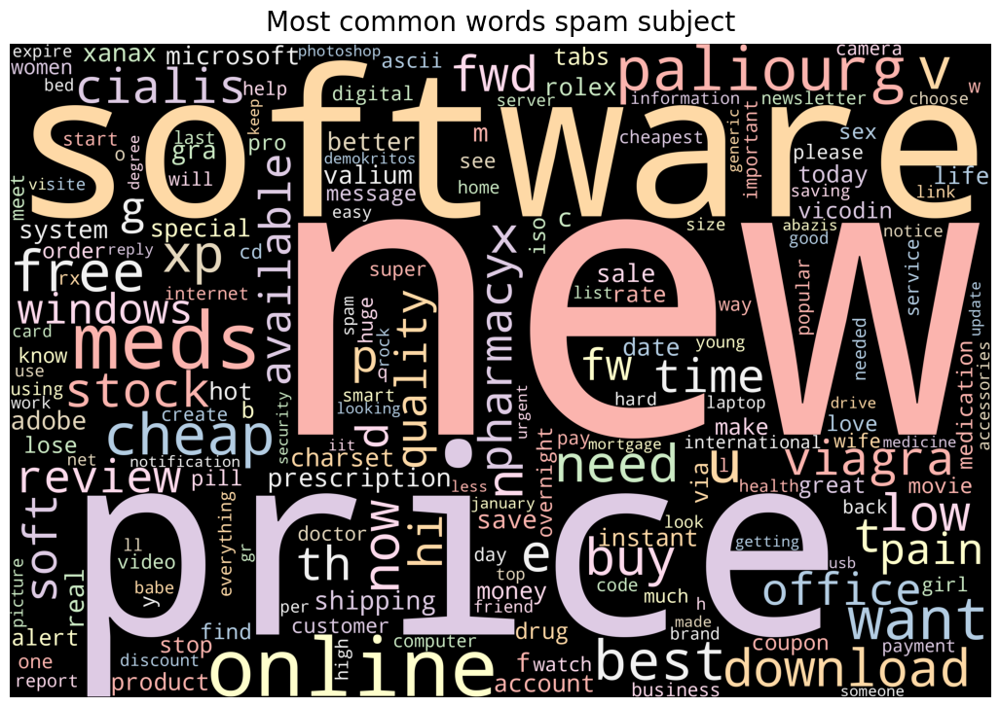

In [ ]:
# show the most common words
Spam_Subject_wordcloud = make_wordcloud(Subject_corpus_spam, STOPWORDS)
plt.figure(figsize=(13, 13))
plt.title("Most common words spam subject", fontdict={'size': 20, 'color': 'black',
                                  'verticalalignment': 'bottom'})
plt.imshow(Spam_Subject_wordcloud)
plt.axis("off")
plt.show()

In [ ]:
Spam_Text_wordcloud = make_wordcloud(Text_corpus_spam, STOPWORDS)
plt.figure(figsize=(13, 13))
plt.title("Most common words spam", fontdict={'size': 20, 'color': 'black',
                                  'verticalalignment': 'bottom'})
plt.imshow(Spam_Text_wordcloud)
plt.axis("off")
plt.show()

In [58]:
Email_text_corpus = []
for line in dataset['Email_text']:
    words = line.split(" ")
    Email_text_corpus.append(words)

In [59]:
model = Word2Vec(Email_text_corpus, min_count=1, vector_size=56)

In [60]:
X = model.wv[model.wv.key_to_index]
pca = PCA(n_components=2)
result = pca.fit_transform(X)
pca_df = pd.DataFrame(result, columns = ['x','y'])

In [61]:
pca_df.head()

,x,y
0,6.669470,-2.706379
1,8.460282,8.697526
2,8.049170,9.052896
3,11.594684,-13.013477
4,6.678427,6.752158


In [ ]:
N = 1000000
words = list(model.wv.key_to_index)
fig = go.Figure(data=go.Scattergl(
   x = pca_df['x'],
   y = pca_df['y'],
   mode='markers',
   marker=dict(
       color=np.random.randn(N),
       colorscale='Viridis',
       line_width=1
   ),
   text=words,
   textposition="bottom center"
))

fig.show()

In [73]:
X = dataset['Email_text']
y = dataset['Labels'].values

In [74]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [75]:
vectorizer = CountVectorizer()
X_train = vectorizer.fit_transform(X_train).toarray()

X_test = vectorizer.transform(X_test).toarray()

In [76]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
X_train = torch.tensor(X_train, dtype=torch.float32).to(device)
y_train = torch.tensor(y_train, dtype=torch.float32).to(device)
X_test = torch.tensor(X_test, dtype=torch.float32).to(device)
y_test = torch.tensor(y_test, dtype=torch.float32).to(device)

In [78]:
class LogisticRegression(nn.Module):
    def __init__(self, input_dim):
        super(LogisticRegression, self).__init__()
        self.linear = nn.Linear(input_dim, 1)

    def forward(self, x):
        return torch.sigmoid(self.linear(x))

In [79]:
model = LogisticRegression(X_train.shape[1]).to(device)
criterion = nn.BCELoss()
optimizer = optim.SGD(model.parameters(), lr=0.1)

In [80]:
num_iter = 2000
losses = []

In [81]:
for epoch in range(num_iter):
    model.train()
    optimizer.zero_grad()
    output = model(X_train).squeeze()
    loss = criterion(output, y_train)
    loss.backward()
    optimizer.step()

    losses.append(loss.item())
    if epoch % 100 == 0:
        print(f'Epoch {epoch}, Loss: {loss.item()}')

Epoch 0, Loss: 0.690639078617096
Epoch 100, Loss: 0.18492725491523743
Epoch 200, Loss: 0.1418735384941101
Epoch 300, Loss: 0.12016293406486511
Epoch 400, Loss: 0.10633440315723419
Epoch 500, Loss: 0.09648194909095764
Epoch 600, Loss: 0.08897845447063446
Epoch 700, Loss: 0.08300329744815826
Epoch 800, Loss: 0.07809049636125565
Epoch 900, Loss: 0.07395274937152863
Epoch 1000, Loss: 0.07040179520845413
Epoch 1100, Loss: 0.06730825453996658
Epoch 1200, Loss: 0.06457976996898651
Epoch 1300, Loss: 0.062148407101631165
Epoch 1400, Loss: 0.059962790459394455
Epoch 1500, Loss: 0.057983312755823135
Epoch 1600, Loss: 0.056178826838731766
Epoch 1700, Loss: 0.054524458944797516
Epoch 1800, Loss: 0.05300005525350571
Epoch 1900, Loss: 0.05158909037709236


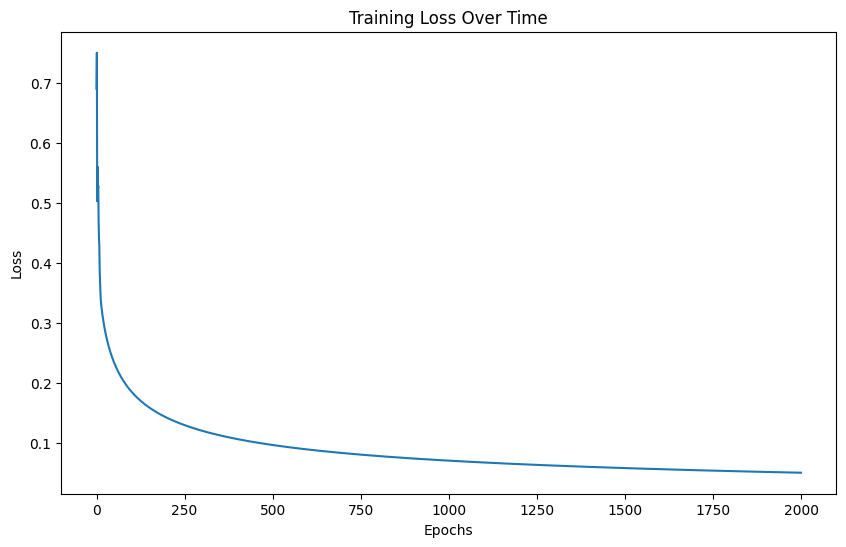

In [82]:
plt.figure(figsize=(10, 6))
plt.plot(losses)
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Training Loss Over Time')
plt.show()

In [83]:
model.eval()
with torch.no_grad():
    y_pred = model(X_test).squeeze().round()

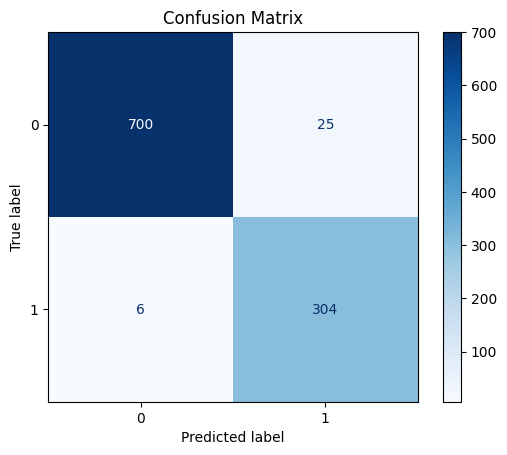

In [84]:
cm = confusion_matrix(y_test.cpu().numpy(), y_pred.cpu().numpy())
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=[0, 1])
disp.plot(cmap=plt.cm.Blues)
plt.title('Confusion Matrix')
plt.show()

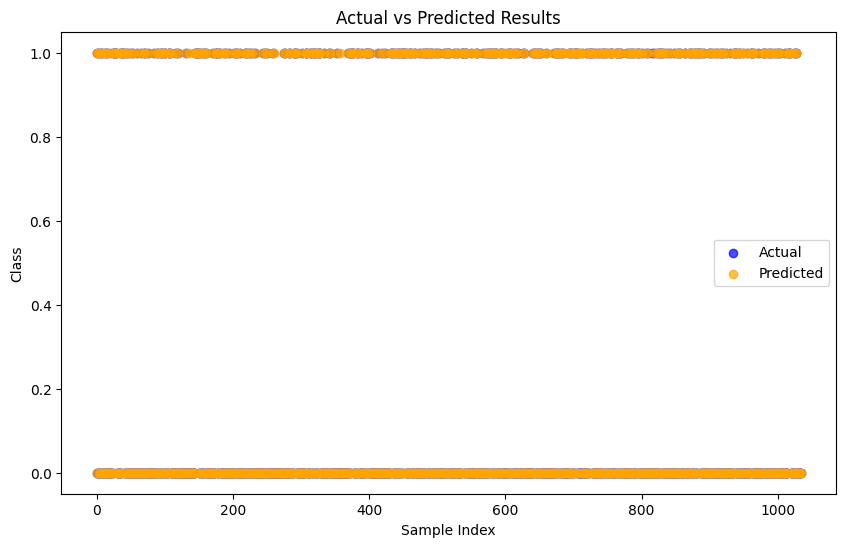

Classification Report:
              precision    recall  f1-score   support

         0.0       0.99      0.97      0.98       725
         1.0       0.92      0.98      0.95       310

    accuracy                           0.97      1035
   macro avg       0.96      0.97      0.96      1035
weighted avg       0.97      0.97      0.97      1035



In [85]:
plt.figure(figsize=(10, 6))
plt.scatter(range(len(y_test)), y_test.cpu(), label='Actual', alpha=0.7, color='blue')
plt.scatter(range(len(y_pred)), y_pred.cpu(), label='Predicted', alpha=0.7, color='orange')
plt.legend()
plt.xlabel('Sample Index')
plt.ylabel('Class')
plt.title('Actual vs Predicted Results')
plt.show()

# report
print('Classification Report:')
print(classification_report(y_test.cpu().numpy(), y_pred.cpu().numpy()))

## SVM

In [ ]:
nltk.download('stopwords')
stop_words = set(stopwords.words('english'))

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
def preprocess_text(text):
    text = text.lower()
    text = ''.join(char for char in text if char not in string.punctuation)
    text = ' '.join(word for word in text.split() if word not in stop_words)
    return text

In [ ]:
data = pd.read_csv('/content/drive/MyDrive/CS410/spam_ham_dataset.csv')
data['text'] = data['text'].apply(preprocess_text)

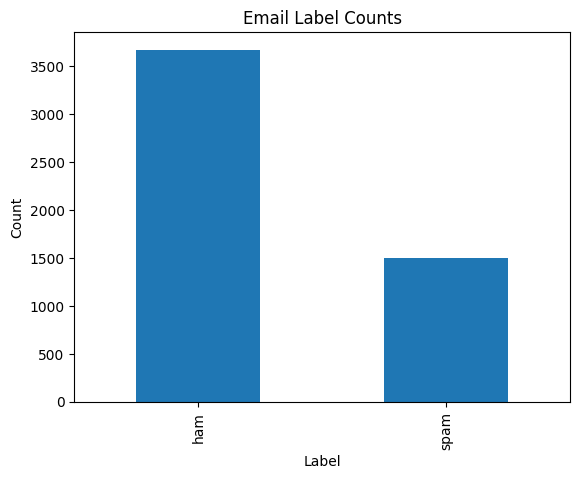

In [ ]:
label_counts = data['label'].value_counts()
label_counts.plot.bar()
plt.title("Email Label Counts")
plt.xlabel("Label")
plt.ylabel("Count")
plt.show()

In [ ]:
vectorizer = TfidfVectorizer(stop_words='english', max_features=5000, ngram_range=(1, 2))
X_transformed = vectorizer.fit_transform(data['text'])
y = data['label']

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_transformed, y, test_size=0.2)

In [ ]:
param_grid = {'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']}
grid_search = GridSearchCV(SVC(), param_grid, cv=3, scoring='accuracy')
grid_search.fit(X_train, y_train)

GridSearchCV(cv=3, estimator=SVC(),
             param_grid={'C': [0.1, 1, 10], 'kernel': ['linear', 'rbf']},
             scoring='accuracy')

In [ ]:
print(f"Best Parameters: {grid_search.best_params_}")
svm_model = grid_search.best_estimator_

Best Parameters: {'C': 1, 'kernel': 'linear'}


In [ ]:
svm_model.fit(X_train, y_train)
y_pred = svm_model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")
print(classification_report(y_test, y_pred))

Accuracy: 0.9826086956521739
              precision    recall  f1-score   support

         ham       0.99      0.99      0.99       747
        spam       0.96      0.98      0.97       288

    accuracy                           0.98      1035
   macro avg       0.98      0.98      0.98      1035
weighted avg       0.98      0.98      0.98      1035



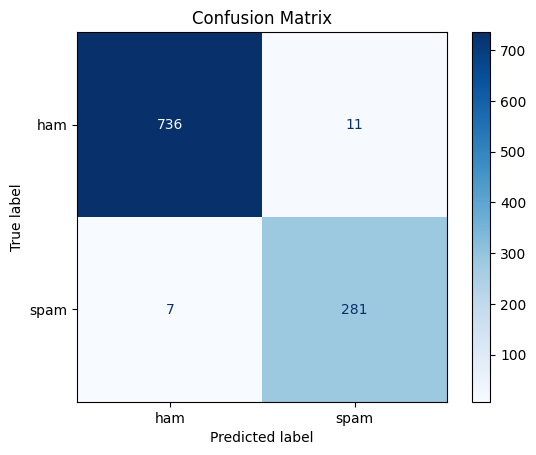

In [ ]:
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=svm_model.classes_)
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.show()

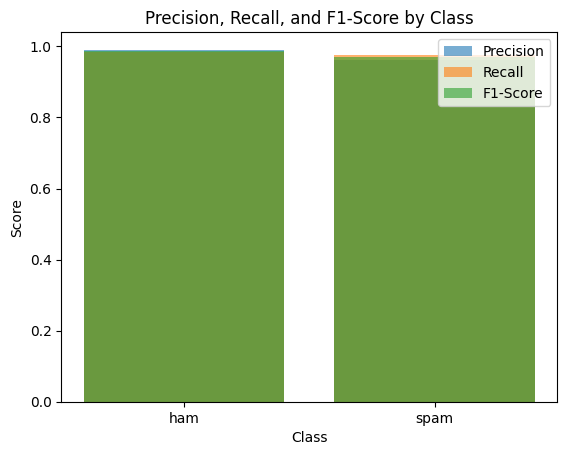

In [ ]:
metrics = precision_recall_fscore_support(y_test, y_pred, average=None, labels=svm_model.classes_)
labels = svm_model.classes_

plt.bar(labels, metrics[0], label='Precision', alpha=0.6)
plt.bar(labels, metrics[1], label='Recall', alpha=0.6)
plt.bar(labels, metrics[2], label='F1-Score', alpha=0.6)
plt.title("Precision, Recall, and F1-Score by Class")
plt.xlabel("Class")
plt.ylabel("Score")
plt.legend()
plt.show()